## Visualizing the nnDetection bounding boxes and tracking them over the timesteps

In [19]:
import pickle
import nibabel as nib
import matplotlib.pyplot as plt
import numpy as np

#### Some data inspection on the keys

In [20]:
file_path = '../data/nnDetection/boxes/100002$1.2.840.113654.2.55.68425808326883186792123057288612355322$1.2.840.113654.2.55.257926562693607663865369179341285235858$STANDARD$2.5$0_boxes.pkl'

with open(file_path, 'rb') as file:
    bounding_boxes = pickle.load(file)

bounding_boxes.keys()

dict_keys(['pred_boxes', 'pred_scores', 'pred_labels', 'restore', 'original_size_of_raw_data', 'itk_origin', 'itk_spacing', 'itk_direction'])

In [21]:
print(bounding_boxes['itk_direction'])

(1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)


## Load files
### Either nifti or npz file (not both :))

In [33]:
nifti = True

In [34]:
image_data_nifti = []

if nifti:
    file_path_nifti = '../data/nnDetection/nifti/100314$1.2.840.113654.2.55.28136324752334562797487795892635498784$1.2.840.113654.2.55.111125240209892628153607300893986842469$STANDARD$2.5$1_0000.nii.gz'
    nifti_image = nib.load(file_path_nifti)
    image_data_nifti = nifti_image.get_fdata()

else:
    # load image data from npz file
    file_path_npz = '../data/nnDetection/nifti/100002$1.2.840.113654.2.55.68425808326883186792123057288612355322$1.2.840.113654.2.55.257926562693607663865369179341285235858$STANDARD$2.5$0.npz'
    image_data_nifti = np.load(file_path_npz)['data'][0]
    # image_data = np.rot90(image_data, 2)
    # image_data = np.swapaxes(image_data, 1, 2)

In [24]:
print(np.min(image_data_nifti), np.max(image_data_nifti))

-3024.0 2145.0


In [26]:
image_data_nifti = np.transpose(image_data_nifti, (2, 1, 0))

(144, 512, 512) (252, 512, 512)


In [27]:
def clip_and_normalize(array, min_value, max_value):
    """
    Clip and normalize the input array.

    This function clips the input array to a specified range and then normalizes it to a 0-255 scale.

    Parameters:
    - array: the input array to be processed.
    - min_value: the minimum value to clip the array to.
    - max_value: the maximum value to clip the array to.

    Returns:
    - normalized_array: the clipped and normalized array.
    """

    clipped_array = np.clip(array, min_value, max_value)
    
    normalized_array = ((clipped_array - min_value) / (max_value - min_value)) * 255
    
    normalized_array = normalized_array.astype(np.uint8)
    
    return normalized_array

In [28]:
image_data = clip_and_normalize(image_data_nifti, -1250, 250)

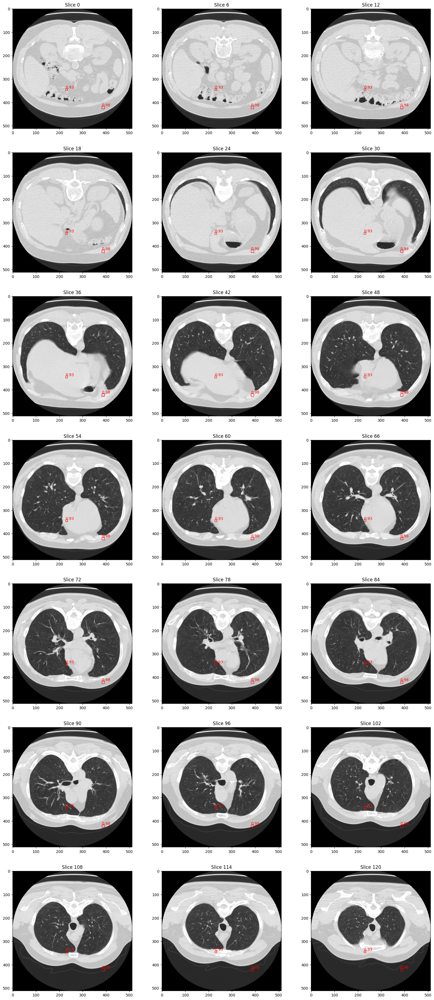

In [29]:
sorted_boxes = sorted(bounding_boxes['pred_boxes'], key=lambda x: x[0], reverse=True)[:5]
axis = 0

num_slices_to_show = 21
threshold = 0.9
num_rows = num_slices_to_show // 3

fig, axes = plt.subplots(num_rows, 3, figsize=(20, 20*num_rows/3))
axes = axes.flatten()


for i in range(num_slices_to_show):
    slice_index = i * (image_data.shape[axis] // num_slices_to_show)
    if slice_index < image_data.shape[axis]:
        axes[i].imshow(np.take(image_data, slice_index, axis=axis), cmap='gray')
        axes[i].set_title(f'Slice {slice_index}')
        for box, score in zip(sorted_boxes, bounding_boxes['pred_scores']):
            z1, x1, z2, x2, y1, y2 = box
            if score >= threshold:
                axes[i].add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=1, edgecolor='r', facecolor='none'))
                axes[i].text(x1, y1, f'{score:.2f}', color='r')
plt.show()


### Tracking bounding boxes over all timesteps

In [ ]:
def plot_bounding_boxes(image_data, bounding_boxes, axis=0, num_slices_to_show=21, threshold=0.9):
    """
    Plot bounding boxes on slices of the image data.

    This function takes preprocessed image data and bounding boxes, then plots the bounding boxes on the specified number of slices of the image data.

    Parameters:
    - image_data (numpy.ndarray): The preprocessed image data to plot.
    - bounding_boxes (dict): A dictionary containing the bounding boxes and their scores. Expected to have keys 'pred_boxes' and 'pred_scores'.
    - axis (int, optional): The axis along which to take slices of the image data. Defaults to 0.
    - num_slices_to_show (int, optional): The number of slices to display. Defaults to 21.
    - threshold (float, optional): The minimum score a bounding box must have to be displayed. Defaults to 0.9.
    """

    image_data = np.transpose(image_data, (2, 1, 0))

    num_rows = num_slices_to_show // 3

    fig, axes = plt.subplots(num_rows, 3, figsize=(20, 20*num_rows/3))
    axes = axes.flatten()

    sorted_boxes = sorted(bounding_boxes['pred_boxes'], key=lambda x: x[0], reverse=True)[:5]

    for i in range(num_slices_to_show):
        slice_index = i * (image_data.shape[axis] // num_slices_to_show)
        if slice_index < image_data.shape[axis]:
            axes[i].imshow(np.take(image_data, slice_index, axis=axis), cmap='gray')
            axes[i].set_title(f'Slice {slice_index}')
            for box, score in zip(sorted_boxes, bounding_boxes['pred_scores']):
                z1, x1, z2, x2, y1, y2 = box
                if score >= threshold:
                    axes[i].add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=1, edgecolor='r', facecolor='none'))
                    axes[i].text(x1, y1, f'{score:.2f}', color='r')
    plt.show()


def load_nifti_and_bounding_boxes(file_path_nifti, file_path_bb):
    """
    Load nifti image and bounding boxes from specified file paths.

    Parameters:
    - file_path_nifti (str): The file path to the nifti image.
    - file_path_bb (str): The file path to the bounding boxes.

    Returns:
    - image_data: The loaded and preprocessed nifti image data.
    - bounding_boxes: The loaded bounding boxes.
    """
    nifti_image = nib.load(file_path_nifti)
    image_data_nifti = nifti_image.get_fdata()
    image_data = clip_and_normalize(image_data_nifti, -1250, 250)

    with open(file_path_bb, 'rb') as file:
        bounding_boxes = pickle.load(file)
    
    return image_data, bounding_boxes

#### Plot bounding boxes at T0

In [30]:
# read sequence

file_path_nifti_T0 = '../data/nnDetection/sequence/T0/100053$1.2.840.113654.2.55.293945473586906533448576310458482935957$1.2.840.113654.2.55.332955207485531103000020644241579816819$STANDARD$2.5$0_0000.nii.gz'
nifti_image_T0 = nib.load(file_path_nifti_T0)
image_data_nifti_T0 = nifti_image_T0.get_fdata()

image_data_T0= clip_and_normalize(image_data_nifti_T0, -1250, 250)

In [31]:
# Load bounding boxes
file_path_bb_T0 = '../data/nnDetection/sequence/T0/100053$1.2.840.113654.2.55.293945473586906533448576310458482935957$1.2.840.113654.2.55.65896851226012826164238610004882175470$STANDARD$2.5$0_boxes.pkl'

with open(file_path_bb_T0, 'rb') as file:
    bounding_boxes_T0 = pickle.load(file)

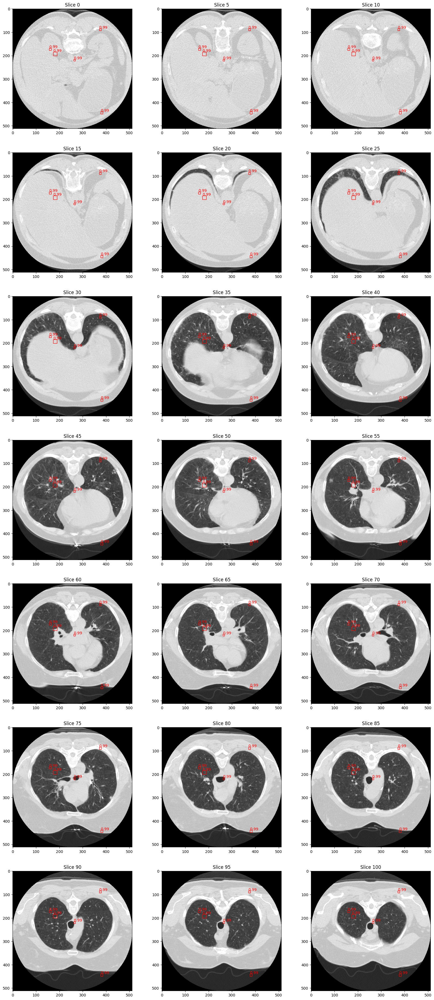

In [6]:
plot_bounding_boxes(image_data_T0, bounding_boxes_T0, axis=0, num_slices_to_show=21, threshold=0.9)

#### Plot bounding boxes at T1

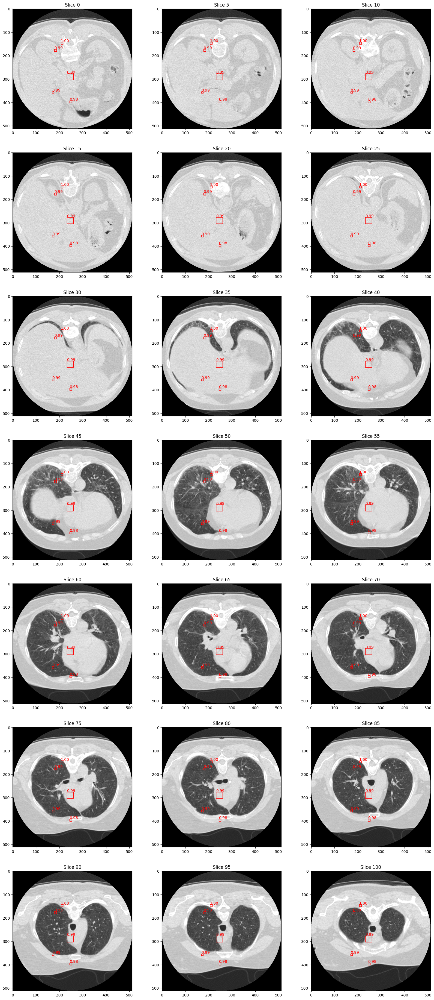

In [7]:
# load T1
file_path_nifti_T1 = '../data/nnDetection/sequence/T1/100053$1.2.840.113654.2.55.152954095196061124982615385551714795472$1.2.840.113654.2.55.99664187318549319245950195606794374964$STANDARD$2.5$1_0000.nii.gz'
file_path_bb_T1 = '../data/nnDetection/sequence/T1/100053$1.2.840.113654.2.55.152954095196061124982615385551714795472$1.2.840.113654.2.55.99664187318549319245950195606794374964$STANDARD$2.5$1_boxes.pkl'

image_data_T1, bounding_boxes_T1 = load_nifti_and_bounding_boxes(file_path_nifti_T1, file_path_bb_T1)

plot_bounding_boxes(image_data_T1, bounding_boxes_T1, axis=0, num_slices_to_show=21, threshold=0.9)

#### Plot bounding boxes at T2

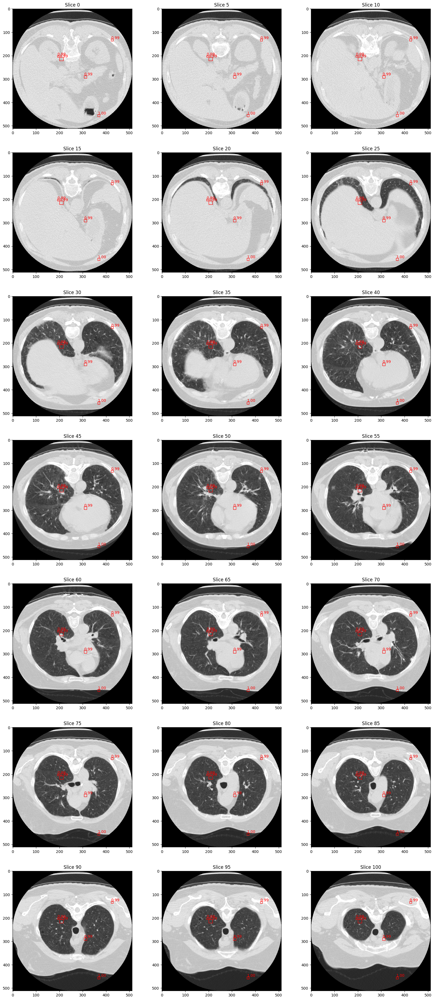

In [16]:
# T2

file_path_nifti_T2 = '../data/nnDetection/sequence/T2/100053$1.2.840.113654.2.55.200515891039643406224341921544274395248$1.2.840.113654.2.55.131209346998202329484871583739303796710$STANDARD$2.5$2_0000.nii.gz'
file_path_bb_T2 = '../data/nnDetection/sequence/T2/100053$1.2.840.113654.2.55.200515891039643406224341921544274395248$1.2.840.113654.2.55.131209346998202329484871583739303796710$STANDARD$2.5$2_boxes.pkl'

image_data_T2, bounding_boxes_T2 = load_nifti_and_bounding_boxes(file_path_nifti_T2, file_path_bb_T2)

plot_bounding_boxes(image_data_T2, bounding_boxes_T2, axis=0, num_slices_to_show=21, threshold=0.9)

#### Calculate the distance between the selected bounding boxes in T0 and every bounding box in T1 to find the closest one

In [9]:
from scipy.spatial import distance

boxes_T0 = bounding_boxes_T0['pred_boxes']
sorted_boxes_T0 = sorted(boxes_T0, key=lambda x: x[0], reverse=True)[:5]

boxes_T1 = bounding_boxes_T1['pred_boxes']
sorted_boxes_T1 = sorted(boxes_T1, key=lambda x: x[0], reverse=True)

# Calculate the distance to the five bounding boxes of T1
for i, box_T1 in enumerate(sorted_boxes_T0):
    print('Box T0:', i)
    distances = [distance.euclidean(box_T1, box_T0) for box_T0 in sorted_boxes_T0]
    min_distance = min(distances)

    print('Distances:', distances)
    print('Min distance:', min_distance)

Box T0: 0
Distances: [0.0, 454.6274719238281, 310.2770080566406, 43.97554397583008, 124.86030578613281]
Min distance: 0.0
Box T0: 1
Distances: [454.6274719238281, 0.0, 502.6874084472656, 495.3221435546875, 358.54754638671875]
Min distance: 0.0
Box T0: 2
Distances: [310.2770080566406, 502.6874084472656, 0.0, 325.5460205078125, 242.16934204101562]
Min distance: 0.0
Box T0: 3
Distances: [43.97554397583008, 495.3221435546875, 325.5460205078125, 0.0, 161.40379333496094]
Min distance: 0.0
Box T0: 4
Distances: [124.86030578613281, 358.54754638671875, 242.16934204101562, 161.40379333496094, 0.0]
Min distance: 0.0


#### Hungarian Tracker to find the most likeley bounding box from T0 to T1

In [10]:
from scipy.spatial import distance
from scipy.optimize import linear_sum_assignment

boxes_T0 = sorted(bounding_boxes_T0['pred_boxes'], key=lambda x: x[0], reverse=True)[:5]
boxes_T1 = bounding_boxes_T1['pred_boxes']

cost_matrix = []
for box_T0 in boxes_T0:
    row = [distance.euclidean(box_T0, box_T1) for box_T1 in boxes_T1]
    cost_matrix.append(row)

# Hungarian algorithm to find the optimal assignment
row_ind, col_ind = linear_sum_assignment(cost_matrix)

new_boxes_T1 = {'pred_boxes': [boxes_T1[i] for i in col_ind], 'pred_scores': [bounding_boxes_T1['pred_scores'][i] for i in col_ind]}

for row, col in zip(row_ind, col_ind):
    print(f"Box {row} in T0 is assigned to Box {col} in T1")
    print(f"Distance: {cost_matrix[row][col]}")

Box 0 in T0 is assigned to Box 25 in T1
Distance: 22.923545837402344
Box 1 in T0 is assigned to Box 16 in T1
Distance: 78.39244079589844
Box 2 in T0 is assigned to Box 20 in T1
Distance: 78.3918685913086
Box 3 in T0 is assigned to Box 8 in T1
Distance: 16.068254470825195
Box 4 in T0 is assigned to Box 55 in T1
Distance: 47.67226028442383


#### Hungarian Tracker to find the most likeley bounding box from T0 to T1

In [ ]:
boxes_T2 = bounding_boxes_T2['pred_boxes']

cost_matrix = []
for box_T0 in boxes_T0:
    row = [distance.euclidean(box_T0, box_T2) for box_T2 in boxes_T2]
    cost_matrix.append(row)

# Hungarian algorithm to find the optimal assignment
row_ind, col_ind = linear_sum_assignment(cost_matrix)

new_boxes_T2 = {'pred_boxes': [boxes_T2[i] for i in col_ind], 'pred_scores': [bounding_boxes_T2['pred_scores'][i] for i in col_ind]}

for row, col in zip(row_ind, col_ind):
    print(f"Box {row} in T0 is assigned to Box {col} in T2")
    print(f"Distance: {cost_matrix[row][col]}")

#### Plotting the tracked bounding boxes from T0 to T2 on the original image from T0

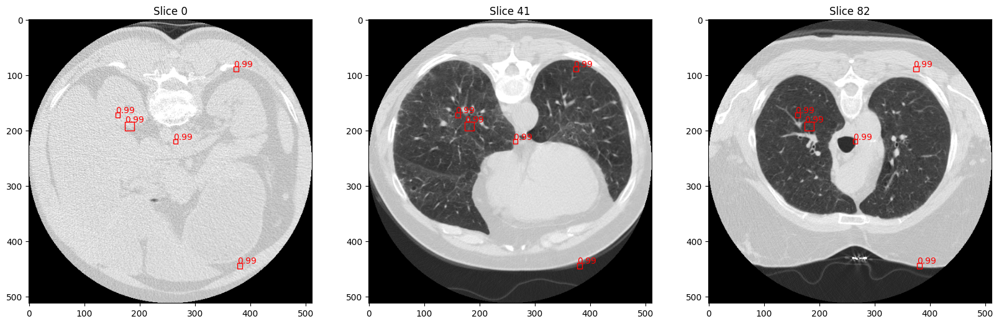

In [12]:
plot_bounding_boxes(image_data_T0, bounding_boxes_T0, axis=0, num_slices_to_show=3, threshold=0.9)

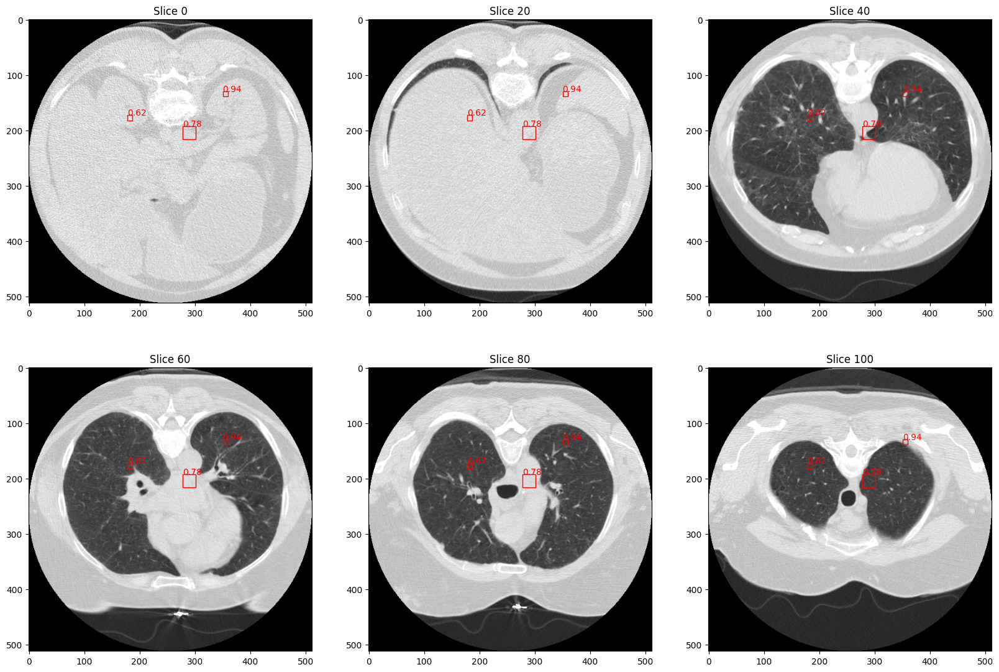

In [13]:
plot_bounding_boxes(image_data_T0, new_boxes_T1, axis=0, num_slices_to_show=6, threshold=0.5)

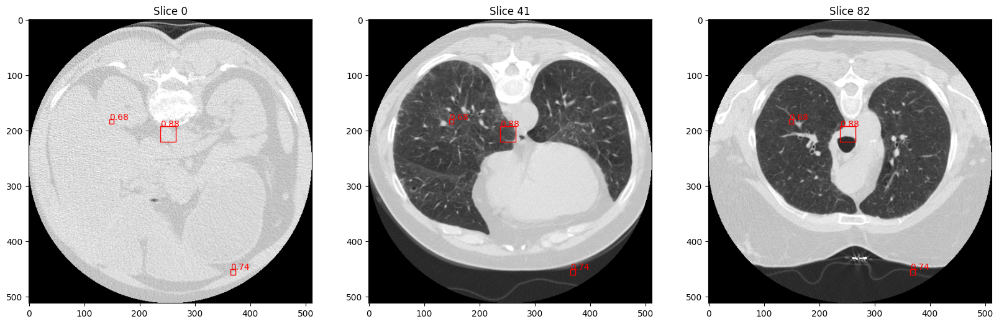

In [55]:
plot_bounding_boxes(image_data_T0, new_boxes_T2, axis=0, num_slices_to_show=3, threshold=0.5)